In [101]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import matplotlib.cm as cm
import networkx as nx
from tqdm import tqdm
from sklearn.cluster import DBSCAN

import utils

%config InlineBackend.figure_format = 'retina'

In [104]:
# Read in data
graph_analysis = pd.read_csv("gammas.csv", index_col=0, header=0)

tsne_embeddings_50 = pd.read_csv('tsne_50dim.csv', skiprows=[0], header=None, names=['ids', 'X', 'Y'])
tsne_embeddings_100 = pd.read_csv('tsne_100dim.csv', skiprows=[0], header=None, names=['ids', 'X', 'Y'])
tsne_embeddings_200 = pd.read_csv('tsne_200dim.csv', skiprows=[0], header=None, names=['ids', 'X', 'Y'])
tsne_embeddings_300 = pd.read_csv('tsne_300dim.csv', skiprows=[0], header=None, names=['ids', 'X', 'Y'])

sdne_embeddings_50 = pd.read_csv('sdne_50dim.csv', skiprows=[0], header=None, names=['ids', 'X', 'Y']).dropna().reset_index().drop(columns=['index'])

node_embeddings_50 = pd.read_csv('../struc2vec/emb/bitcoin-50dims.emb', skiprows=[0], index_col=0, header=None, sep=' ')
node_embeddings_100 = pd.read_csv('../struc2vec/emb/bitcoin-100dims.emb', skiprows=[0], index_col=0, header=None, sep=' ')
node_embeddings_200 = pd.read_csv('../struc2vec/emb/bitcoin-200dims.emb', skiprows=[0], index_col=0, header=None, sep=' ')
node_embeddings_300 = pd.read_csv('../struc2vec/emb/bitcoin-300dims.emb', skiprows=[0], index_col=0, header=None, sep=' ')

# Read in original graph
edge_list = pd.read_csv('../struc2vec/graph/bitcoin-undirected.edgelist', header=0, sep=' ', names=['from', 'to'])
G = nx.from_pandas_edgelist(edge_list, 'from', 'to')
display(sdne_embeddings_50.info())
display(tsne_embeddings_50.info())

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5880 entries, 0 to 5879
Data columns (total 3 columns):
ids    5880 non-null float64
X      5880 non-null float64
Y      5880 non-null float64
dtypes: float64(3)
memory usage: 137.9 KB


None

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5880 entries, 0 to 5879
Data columns (total 3 columns):
ids    5880 non-null int64
X      5880 non-null float64
Y      5880 non-null float64
dtypes: float64(2), int64(1)
memory usage: 137.9 KB


None

In [105]:
embs = [tsne_embeddings_50, tsne_embeddings_100, tsne_embeddings_200, tsne_embeddings_300]
node_embs = [node_embeddings_50, node_embeddings_100, node_embeddings_200, node_embeddings_300]

/usr/local/lib/python3.6/site-packages/matplotlib/figure.py:418: UserWarning: matplotlib is currently using a non-GUI backend, so cannot show the figure
  "matplotlib is currently using a non-GUI backend, "


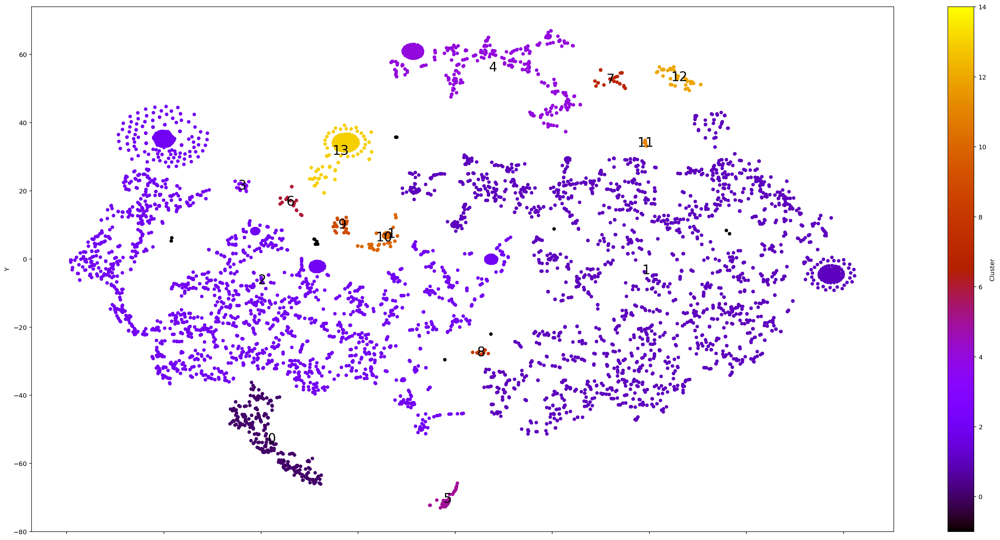

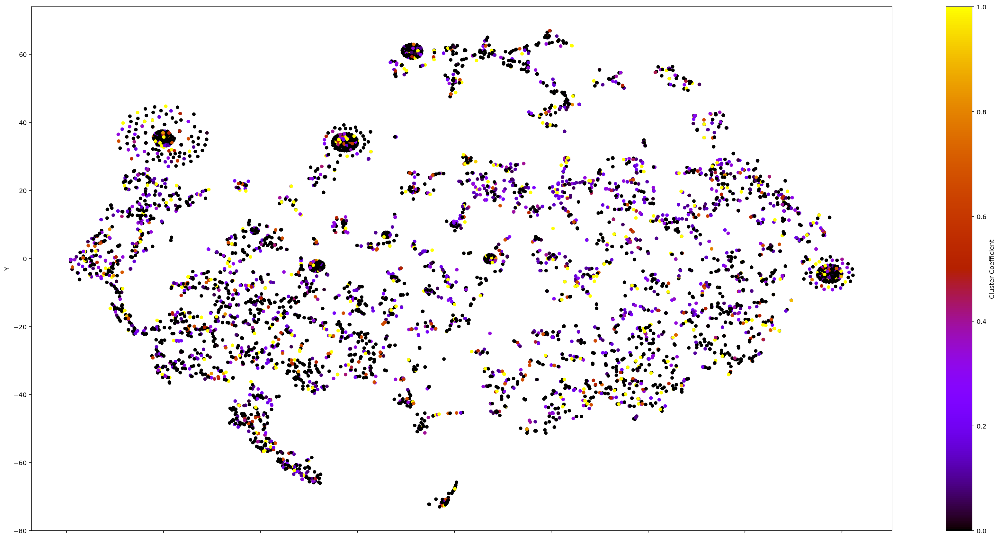

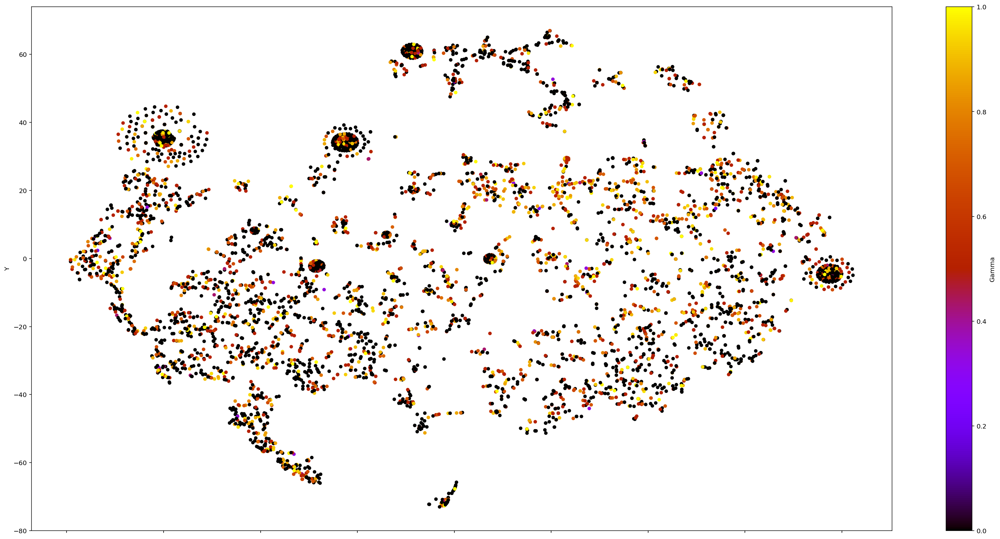

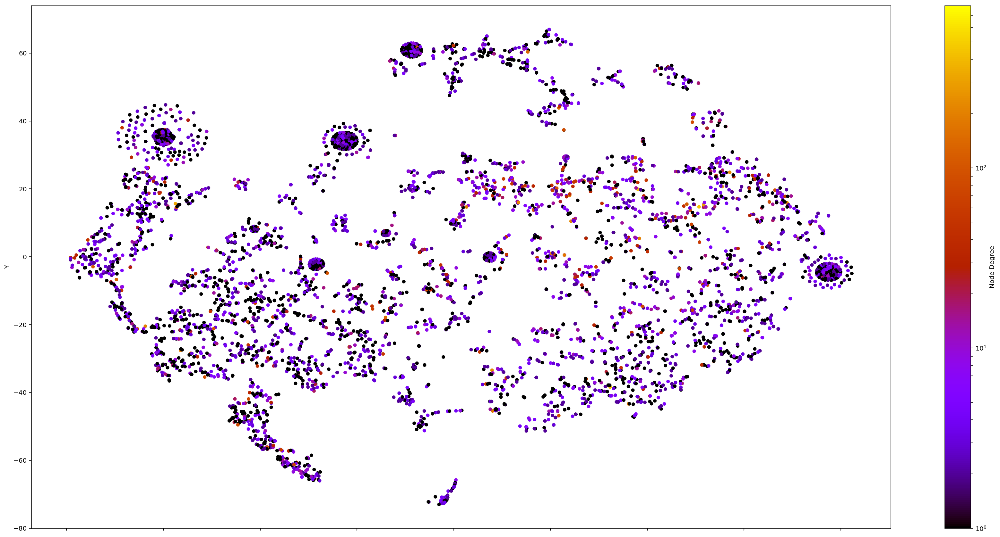

In [106]:
#Plot TSNE cluster with cc as color
for i, emb in enumerate([sdne_embeddings_50]):
    node_emb = node_embs[i]
    emb_copy = emb.copy(deep=True).set_index("ids")
    
    # Plot TSNE with clusters
    clustered_embeddings = utils.enhance_with_clusterings(emb, eps=4, min_samples=10)
    num_clusters = clustered_embeddings['Cluster'].unique().shape[0]
    utils.show_clusters(clustered_embeddings, cluster_labels=True, save=False, save_prefix='img/sdne_50dim')            
    emb_copy = emb_copy.join(graph_analysis)
    utils.show_embedding_plots(emb_copy, save=False, save_prefix='img/sdne_50dim')

In [21]:
clusters = [utils.get_cluster_members(clustered_embeddings, i) for i in [1, 2, 3, 4]]
cluster_neighbors = []
for cluster in clusters:
    neighbors = []
    for node in cluster:
        source, dest = list(G.edges(node))[0]
        neighbor = source if source != node else dest
        neighbors.append(neighbor)
    cluster_neighbors.append(neighbors)

for i, neighbors in enumerate(cluster_neighbors):
    degrees, ccs, gammas = [], [], []
    for node in neighbors:
        egograph = nx.ego_graph(G, node)
        degrees.append(utils.get_degree(egograph, node))
        ccs.append(nx.clustering(egograph, node))
        gammas.append(utils.gamma(egograph, node))
    print("Cluster {}".format(i))
    print("Mean degree {}".format(np.mean(degrees)))
    print("Mean cc {}".format(np.mean(ccs)))
    print("Mean gamma {}".format(np.mean(gammas)))
    
    print("Median degree {}".format(np.median(degrees)))
    print("Median cc {}".format(np.median(ccs)))
    print("Median gamma {}".format(np.median(gammas)))

Cluster 0
Mean degree 22.726633165829146
Mean cc 0.10591828113630584
Mean gamma 0.6427323109569998
Median degree 17.0
Median cc 0.08416130917592052
Median gamma 0.755972287245096
Cluster 1
Mean degree 142.73473684210526
Mean cc 0.05436509518783716
Mean gamma 0.8593975993132982
Median degree 133.0
Median cc 0.04622345979812043
Median gamma 0.8993836116079809
Cluster 2
Mean degree 352.504132231405
Mean cc 0.03233831711844312
Mean gamma 0.9320185338637361
Median degree 436.0
Median cc 0.022893458566064426
Median gamma 0.9298711903538784
Cluster 3
Mean degree 78.234375
Mean cc 0.05066337616805423
Mean gamma 0.8300854165321723
Median degree 78.0
Median cc 0.03983656792645557
Median gamma 0.8338171658036881


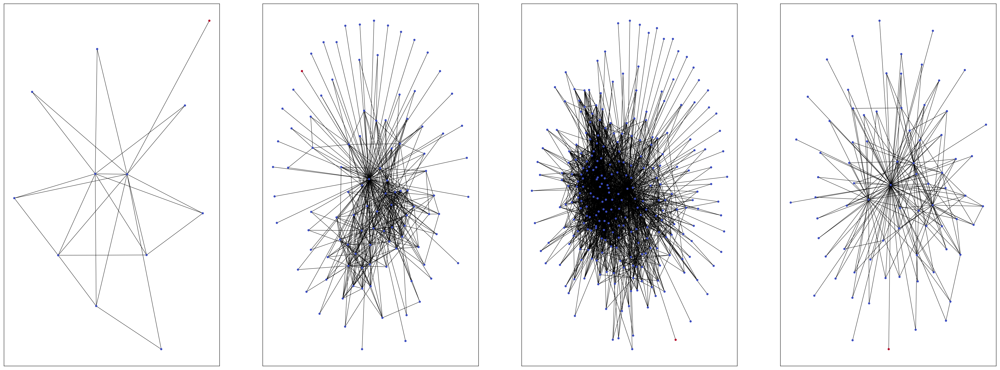

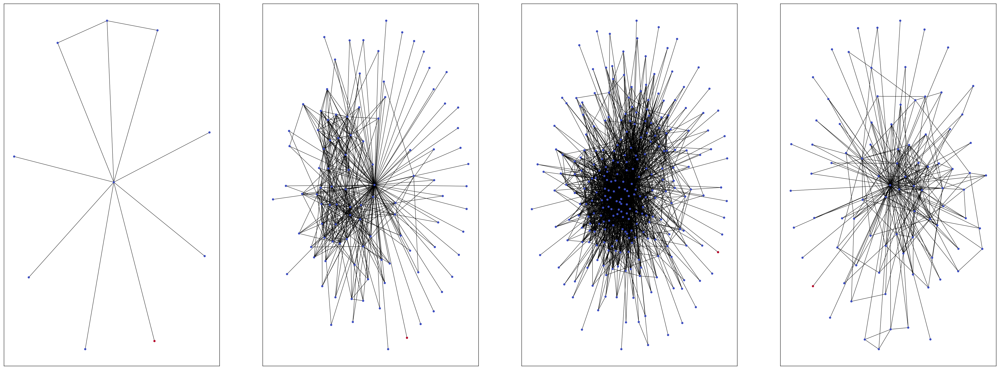

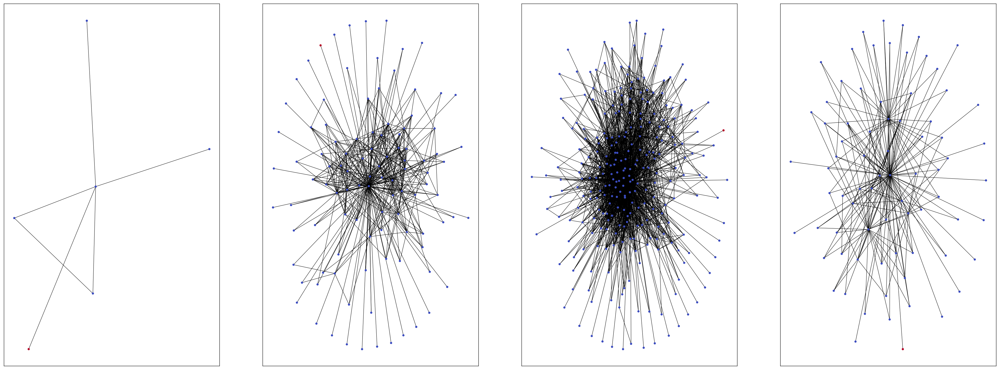

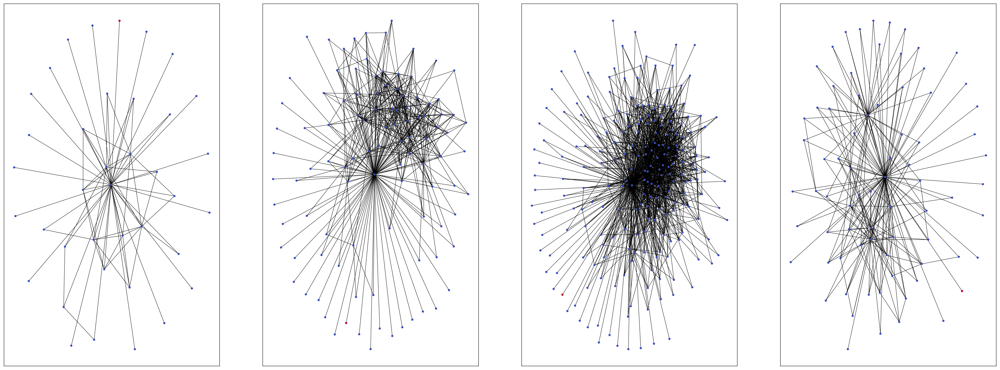

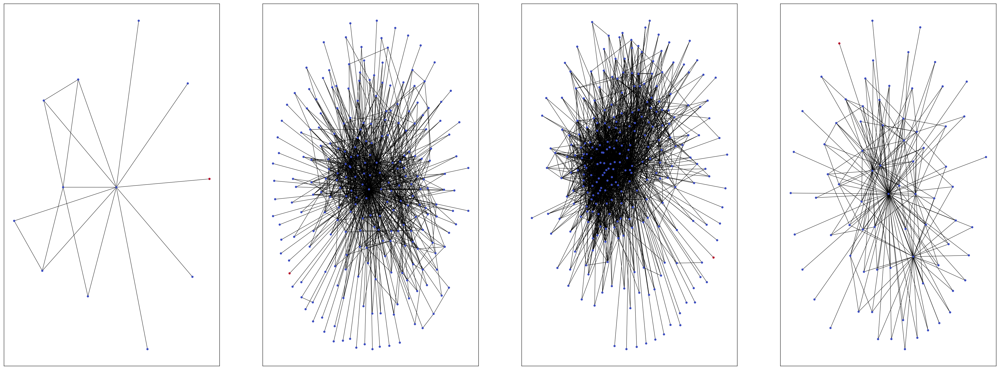

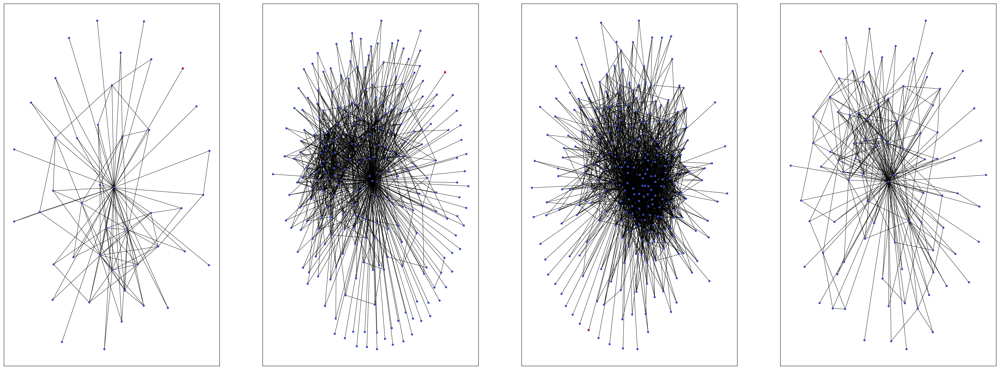

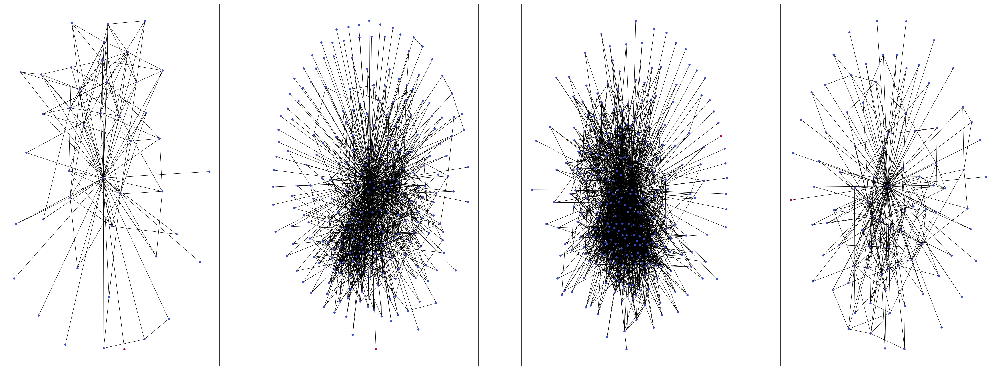

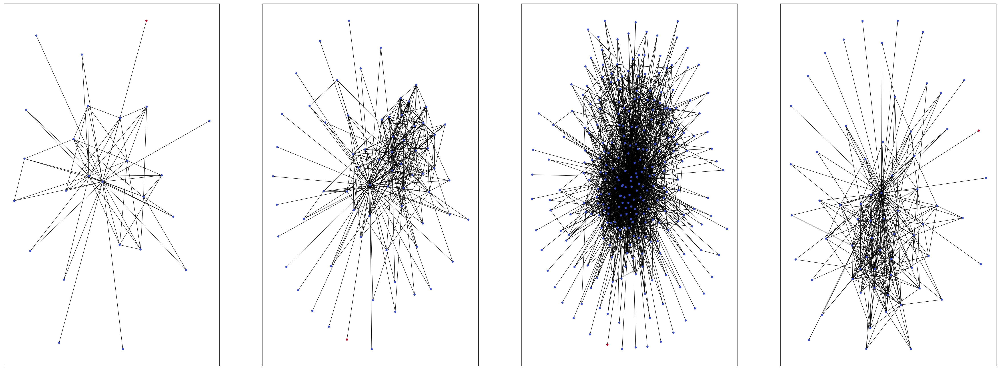

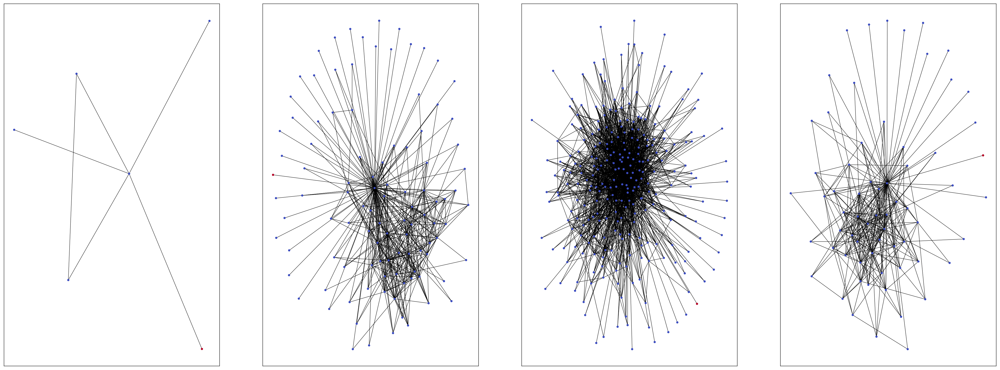

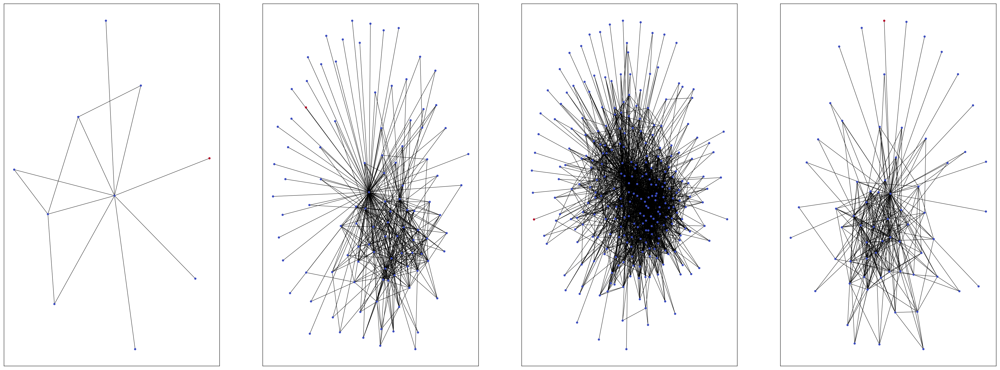

In [22]:
clusters = [utils.get_cluster_members(clustered_embeddings, i) for i in [1, 2, 3, 4]]
min_len = min(list(map(lambda cluster: len(cluster), clusters)))
min_len = 10
clusters = list(map(lambda cluster: cluster[:min_len], clusters))

i = 0
for nodes in zip(*clusters):
    utils.create_egograph_comparison(G, nodes, i, radius=2)
    i += 1

In [6]:
#cluster = [162, 255]
#utils.create_egograph_comparison(G, cluster, save=True, savepath='img/egograph_comparison_5.png')